In [1]:
import networkx as nx
import matplotlib.pyplot as plt
from networkx.algorithms.community import label_propagation_communities
import networkx.algorithms.community as nx_comm
from networkx.algorithms.core import core_number

import numpy as np
import math

In [2]:
def fixedG(oldG):
    # A veces hay aristas repetidas y networkx lee el archivo como
    # "multigrafo", para el cual no funciona k-cores. Así que genero
    # acá una copia simplificada.
    Gsimp = nx.Graph()
    for u,v,data in oldG.edges(data=True):
        if not Gsimp.has_edge(u,v):
            Gsimp.add_edge(u, v)
            
    return Gsimp

In [3]:
def maxKcoreDepth(G):
    iterI = 1
    while nx.k_core(G,iterI).number_of_nodes()!=0: iterI+=1
    return iterI

In [4]:
def meanKCoreShellPlot(G, k_max, netName):
    k_mean = math.ceil(k_max/2)

    fig, axs = plt.subplots(1,2, figsize=(50,25), dpi=60)

    fig.suptitle("Network: {}".format(netName,k_mean), fontsize=60)

    G_kc_mean = nx.k_core(G, k=k_mean)
    nx.draw(G_kc_mean, ax=axs[0], with_labels=True, node_color="skyblue", pos = nx.fruchterman_reingold_layout(G_kc_mean, iterations=100))
    axs[0].set_title('K-core (k={})'.format(k_mean), fontsize=40)

    G_ks_mean = nx.k_shell(G, k=k_mean)
    nx.draw(G_ks_mean, ax=axs[1], with_labels=True, node_color="skyblue", pos = nx.fruchterman_reingold_layout(G_ks_mean, iterations=100))
    axs[1].set_title('K-shell (k={})'.format(k_mean), fontsize=40)
    
    fig.show()

In [5]:
def set_node_community(G, communities):
    '''Add community to node attributes'''
    for c, v_c in enumerate(communities):
        for v in v_c:
            # Add 1 to save 0 for external edges
            G.nodes[v]['community'] = c + 1

def set_edge_community(G):
    '''Find internal edges and add their community to their attributes'''
    for v, w, in G.edges:
        if G.nodes[v]['community'] == G.nodes[w]['community']:
            # Internal edge, mark with community
            G.edges[v, w]['community'] = G.nodes[v]['community']
        else:
            # External edge, mark as 0
            G.edges[v, w]['community'] = 0

def get_color(i, r_off=1, g_off=1, b_off=1):
    '''Assign a color to a vertex.'''
    r0, g0, b0 = 0, 0, 0
    n = 16
    low, high = 0.1, 0.9
    span = high - low
    r = low + span * (((i + r_off) * 3) % n) / (n - 1)
    g = low + span * (((i + g_off) * 5) % n) / (n - 1)
    b = low + span * (((i + b_off) * 7) % n) / (n - 1)
    return (r, g, b)

In [12]:
def plotCommunities(G, nameG):
    # Find the communities
    communities = sorted(nx_comm.greedy_modularity_communities(G), key=len, reverse=True)

    count_node_com = [str(len(i)) for i in communities]
    mod_Q = nx_comm.modularity(G, communities)

    # Set node and edge communities
    set_node_community(G, communities)
    set_edge_community(G)

    node_color = [get_color(G.nodes[v]['community']) for v in G.nodes]

    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in G.edges if G.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in G.edges if G.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    #G_pos = nx.spring_layout(G)
    G_pos = nx.fruchterman_reingold_layout(G, iterations=100)

    plt.subplots(figsize=(50,25), dpi=60)

    #    fig, axs = plt.subplots(1,2, figsize=(50,25), dpi=60)
    title_str = "Network: {0}\n Communities Count: {1}\n Length Communities: {2}\n Modularity (Q): {3}\n".format(
                nameG, len(communities), '[' + ' - '.join(count_node_com) + ']', round(mod_Q,5))
    plt.title(title_str, fontsize=60)

    # Draw external edges
    nx.draw_networkx(
        G,
        pos=G_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        G,
        pos=G_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    plt.show()

## Pregunta 4

Importamos la red usanda en la tarea 1 (red 02 - colaboracion jazz):

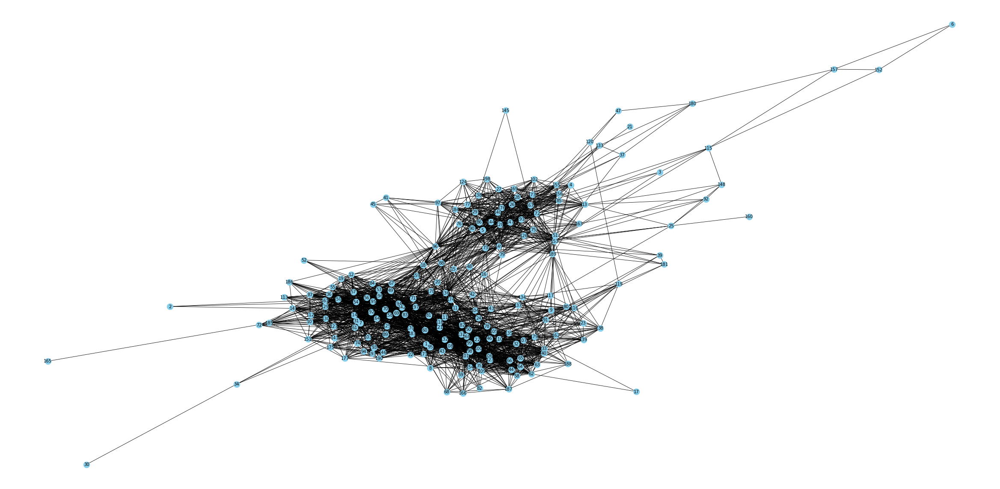

In [7]:
t1_G = fixedG(nx.read_pajek("Net02T1.net").to_undirected())

plt.subplots(figsize=(50,25), dpi=60)
nx.draw(t1_G, with_labels=True, node_color="skyblue", pos = nx.fruchterman_reingold_layout(t1_G, iterations=100))
plt.show()

Generamos las 10 redes aleatorias apartir del graddo de `t1_G`:

In [8]:
G_10_l = [nx.configuration_model([d for v, d in t1_G.degree()], create_using=nx.classes.graph.Graph).to_undirected() for i in range(10)]

def remove_loop_f(G):
    G = nx.Graph(G)
    G.remove_edges_from(nx.selfloop_edges(G))
    return G
G_10_l = list(map(remove_loop_f, G_10_l))

### Nucleo/Periferia

In [9]:
k_max = maxKcoreDepth(t1_G)
print('Original Net: ')
print('[+]Depth K-Core: {}'.format(k_max))
l_k_shell = [nx.k_shell(t1_G, k=i).number_of_nodes() for i in range(1,k_max+1)]
print('[+]List K-shell:',l_k_shell)

for n_i in range(len(G_10_l)):
    aux_net = G_10_l[n_i]
    k_max = maxKcoreDepth(aux_net)
    print('Random Net #{}'.format(n_i + 1))
    print('[+]Depth K-Core: {}'.format(k_max))
    l_k_shell = [nx.k_shell(aux_net, k=i).number_of_nodes() for i in range(1,k_max+1)]
    print('[+]List K-shell:',l_k_shell)

Original Net: 
[+]Depth K-Core: 30
[+]List K-shell: [5, 5, 4, 7, 0, 3, 2, 5, 1, 2, 5, 2, 5, 5, 17, 3, 30, 7, 3, 14, 43, 0, 0, 0, 0, 0, 0, 0, 30, 0]
Random Net #1
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 7, 3, 2, 4, 2, 5, 3, 7, 3, 3, 8, 9, 39, 89, 0]
Random Net #2
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 4, 6, 2, 5, 3, 2, 3, 2, 4, 6, 6, 11, 9, 11, 113, 0]
Random Net #3
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 6, 3, 5, 2, 3, 1, 7, 4, 5, 9, 8, 18, 19, 94, 0]
Random Net #4
[+]Depth K-Core: 19
[+]List K-shell: [6, 2, 3, 3, 5, 4, 4, 5, 1, 2, 2, 6, 8, 11, 6, 9, 13, 108, 0]
Random Net #5
[+]Depth K-Core: 18
[+]List K-shell: [5, 3, 3, 3, 4, 7, 3, 4, 2, 3, 4, 3, 4, 5, 6, 35, 104, 0]
Random Net #6
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 4, 8, 1, 3, 3, 3, 4, 7, 9, 2, 7, 13, 15, 105, 0]
Random Net #7
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 6, 4, 2, 4, 3, 2, 6, 3, 5, 7, 2, 20, 13, 107, 0]
Random Net #8
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 5, 4

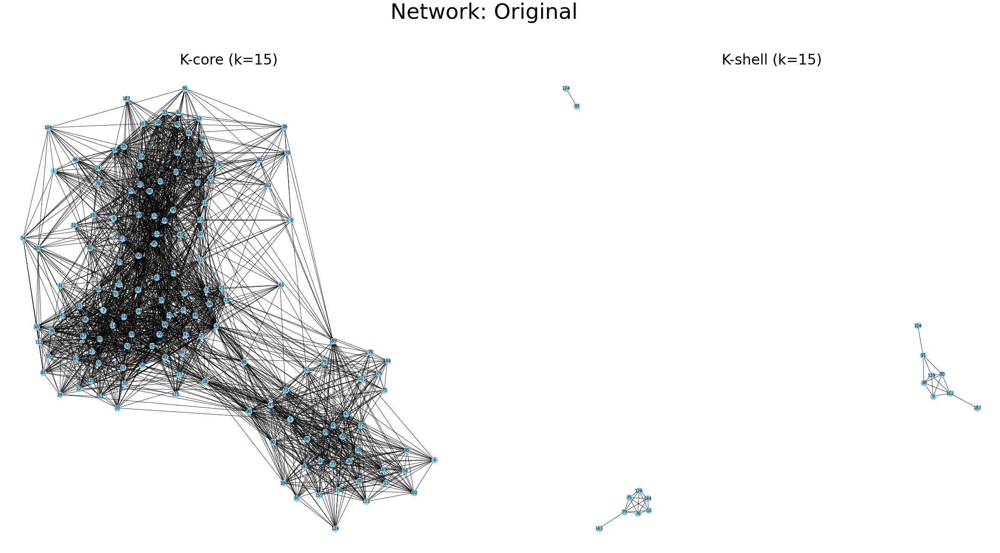

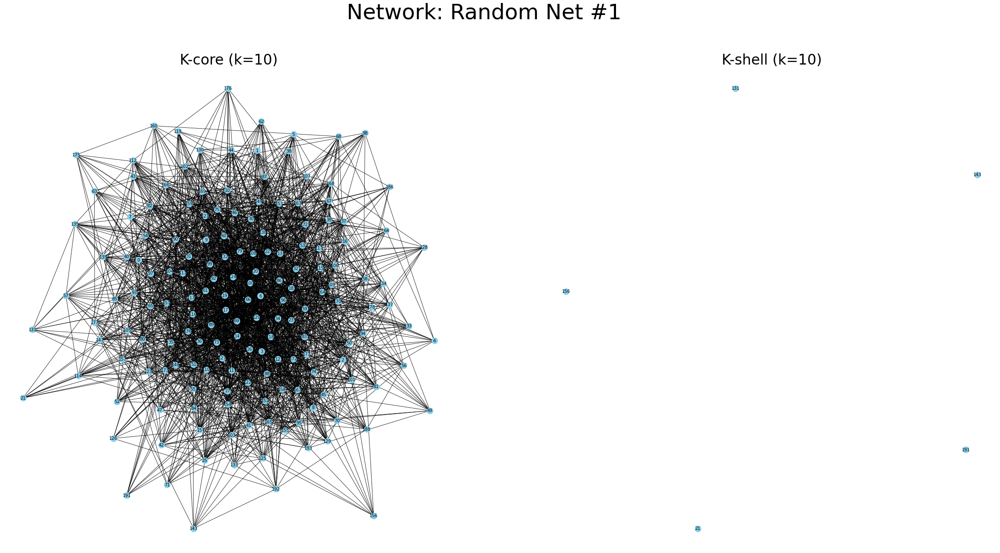

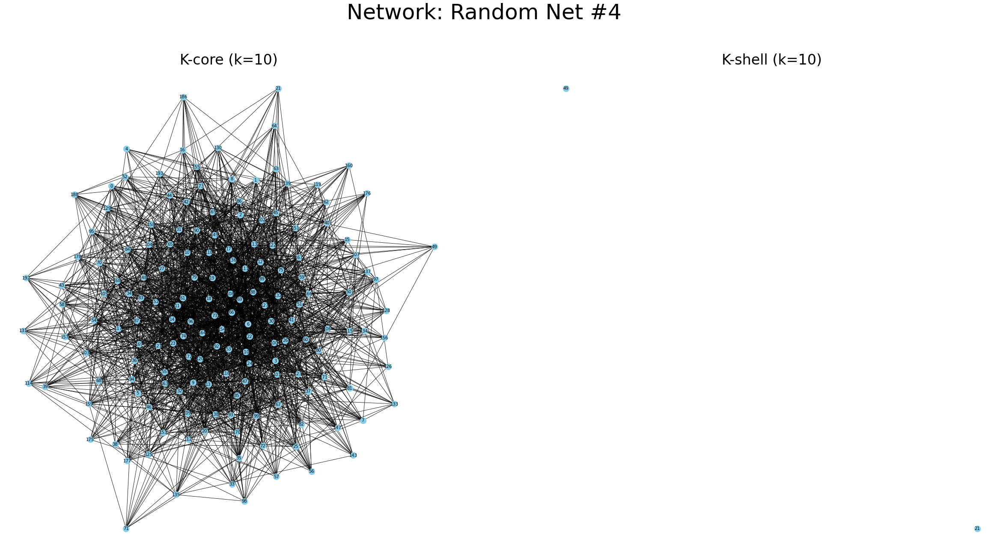

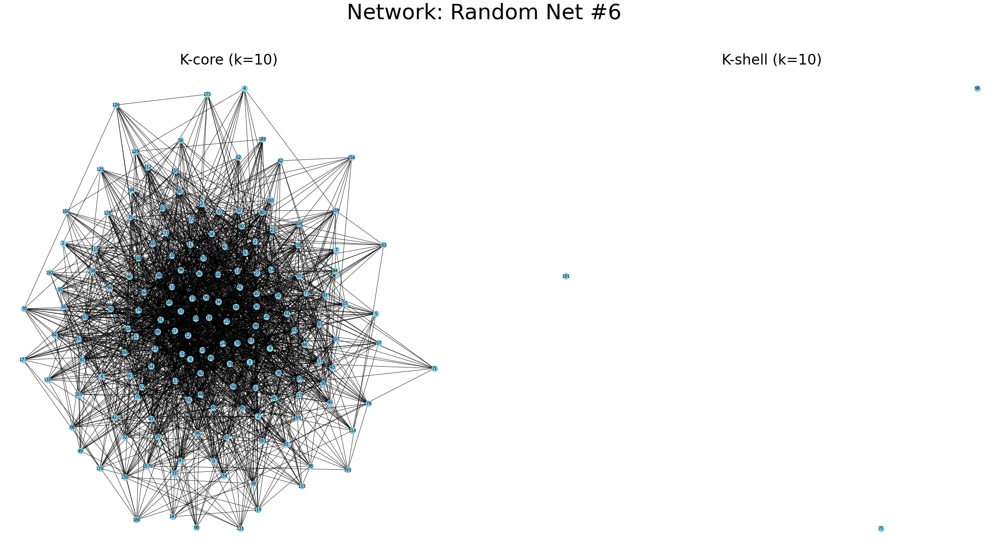

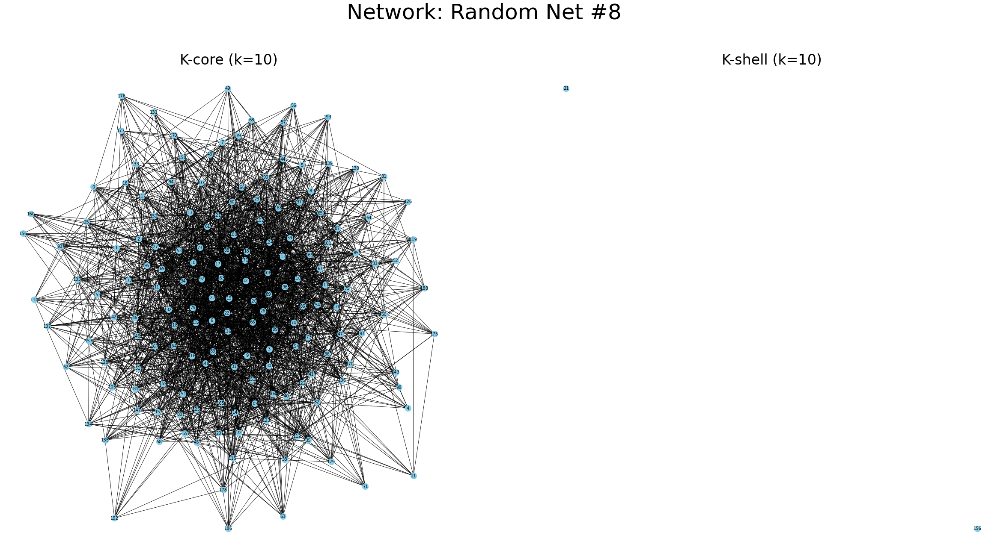

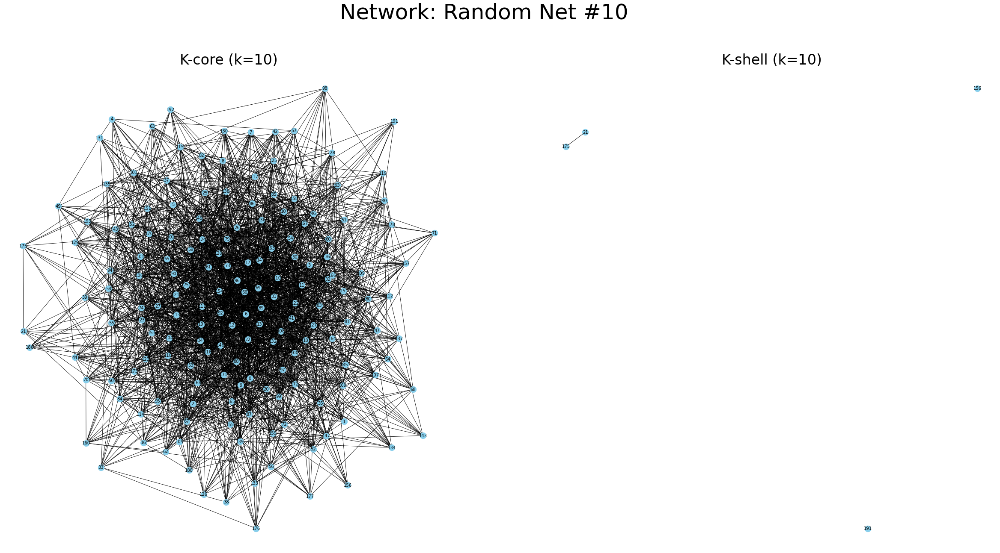

In [10]:
k_max = maxKcoreDepth(t1_G)
meanKCoreShellPlot(t1_G, k_max, 'Original')

for i in [0,3,5,7,9]:
    aux_net = G_10_l[i]
    k_max = maxKcoreDepth(aux_net)
    meanKCoreShellPlot(aux_net, k_max, 'Random Net #{}'.format(i + 1))

### Comunidades

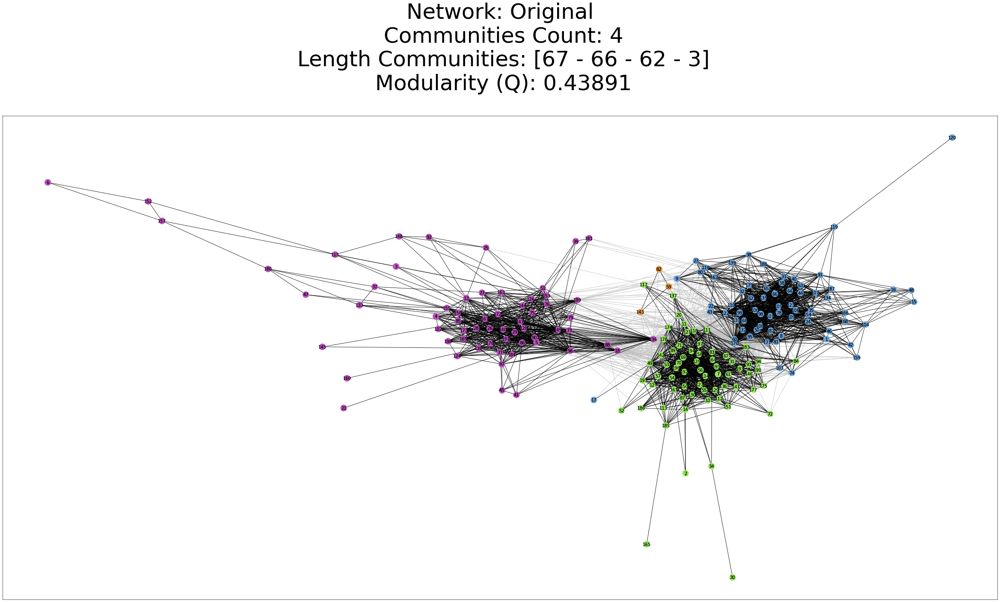

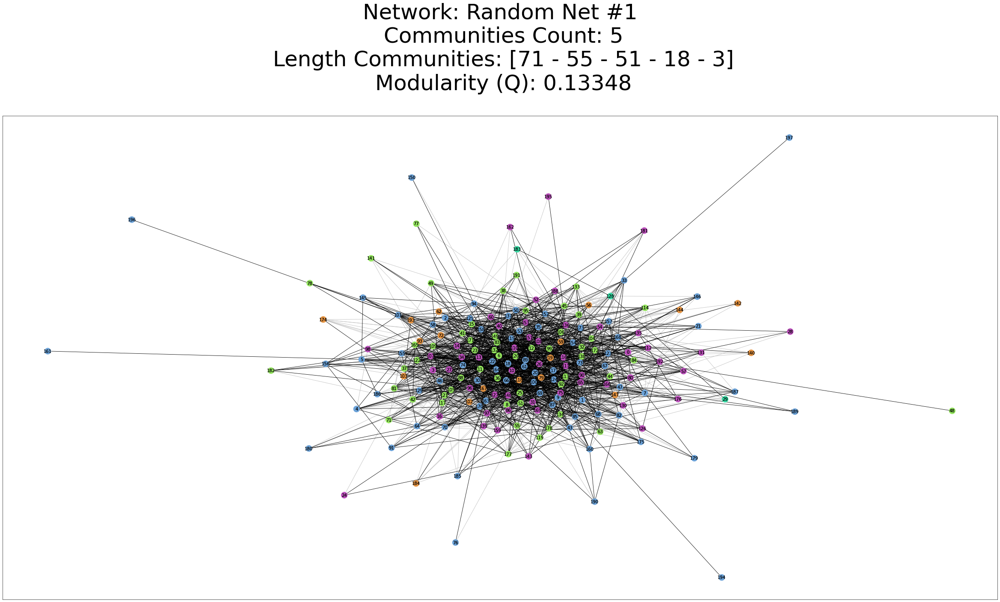

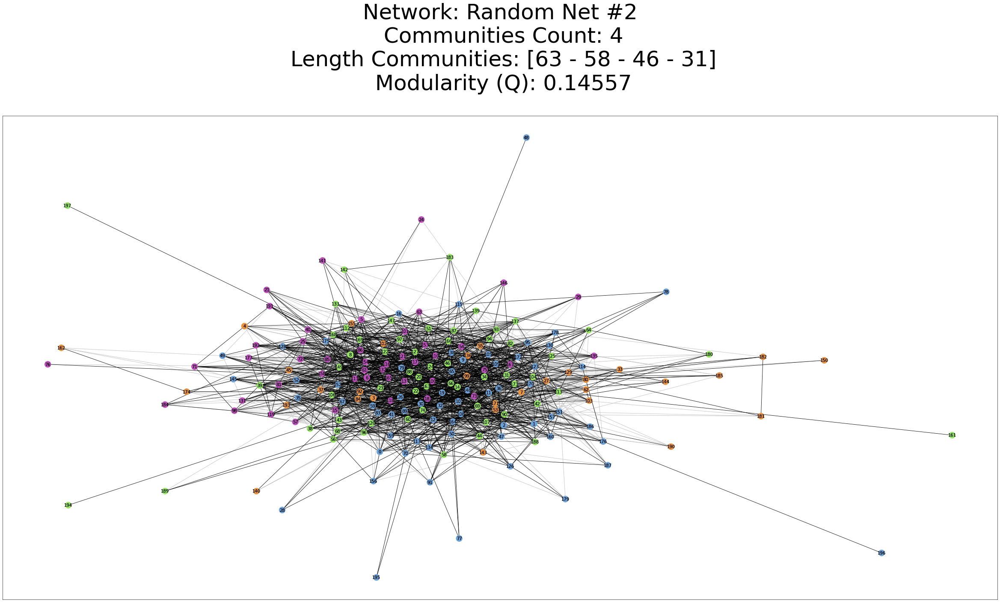

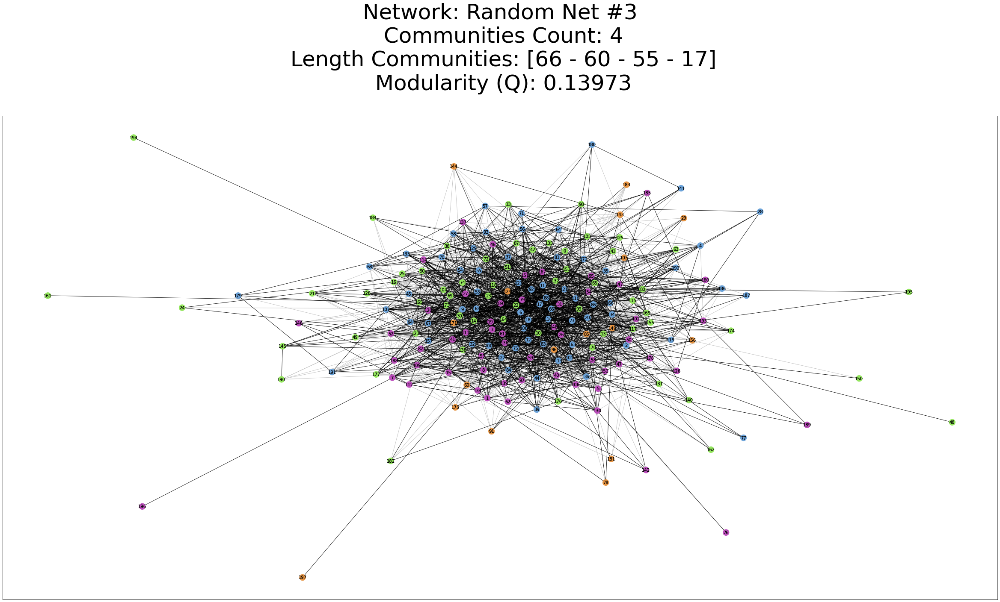

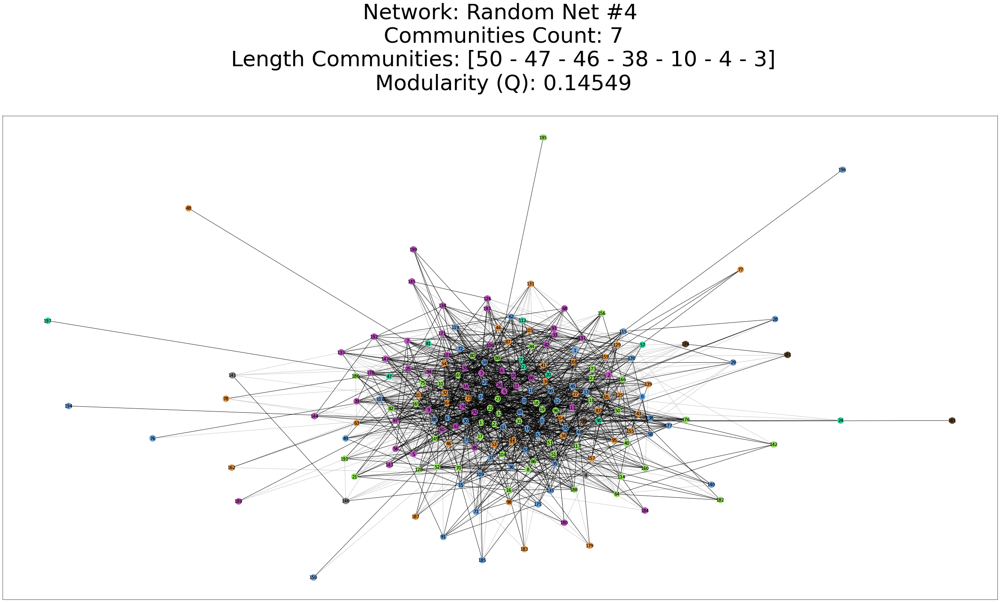

...

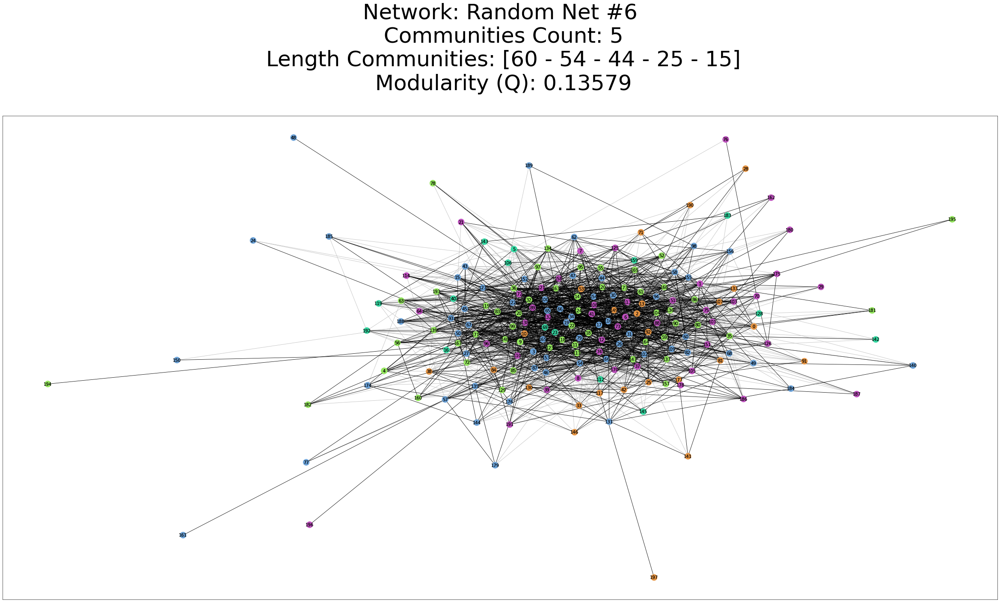

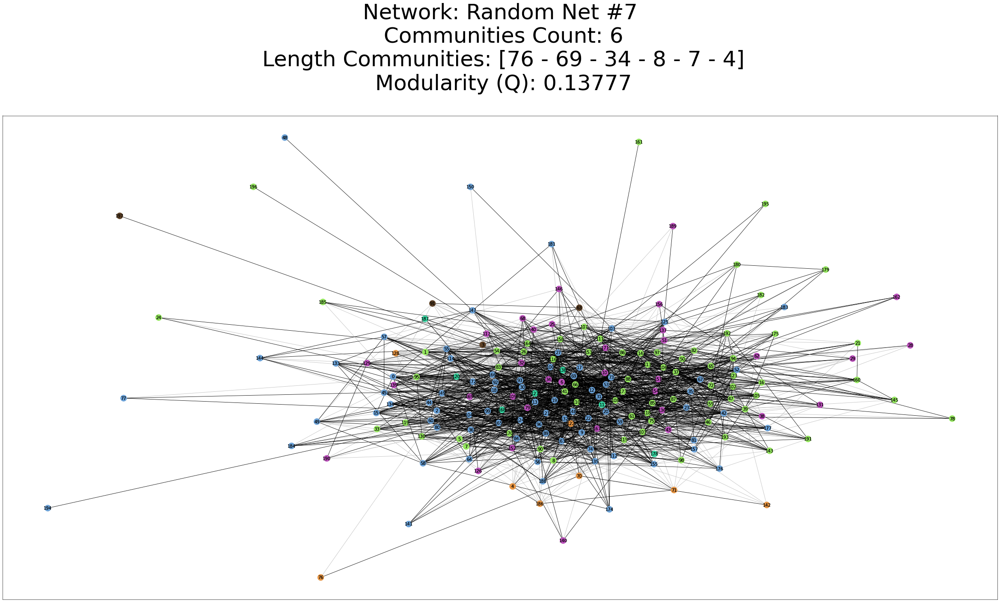

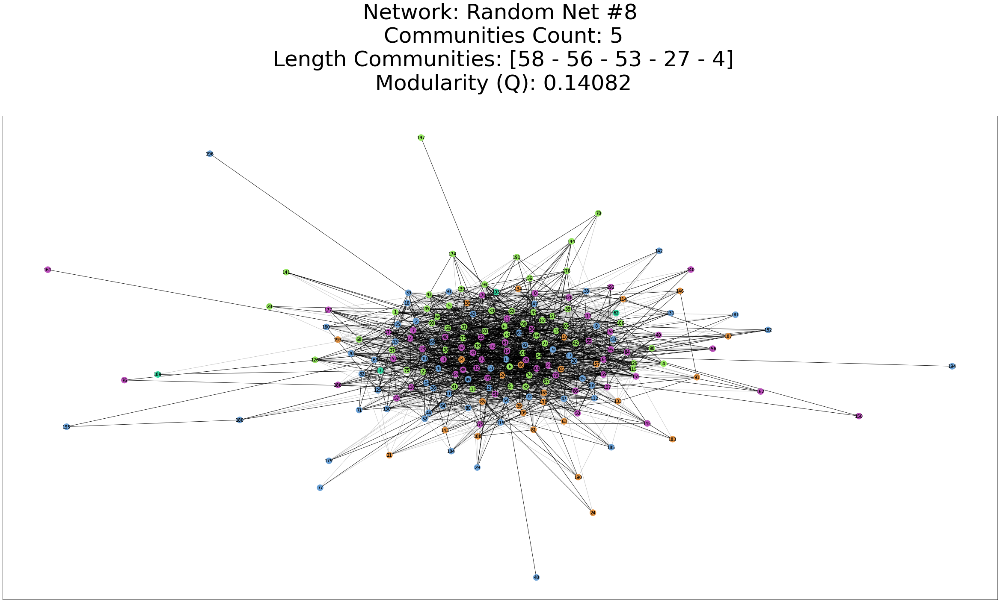

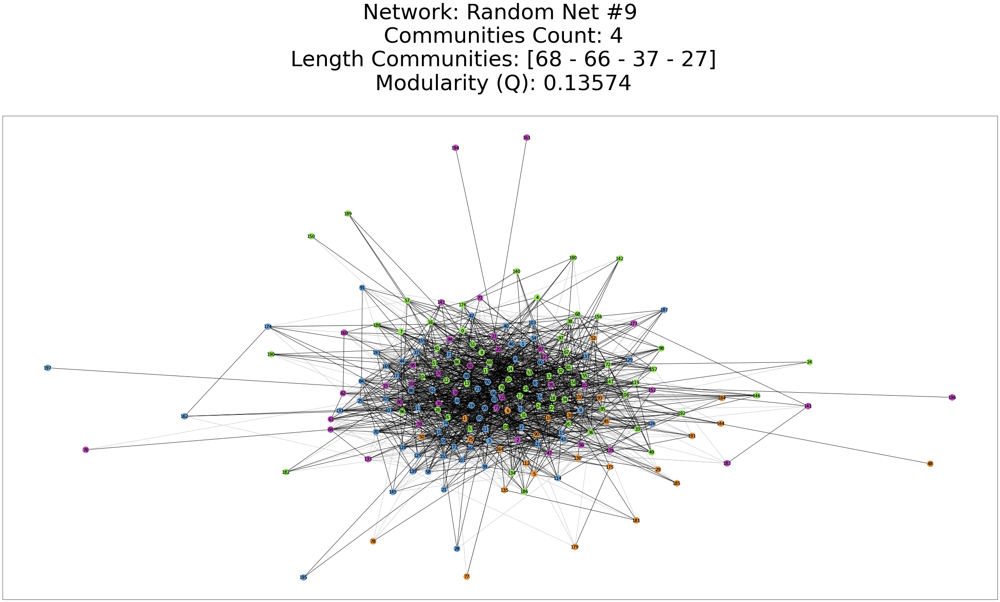

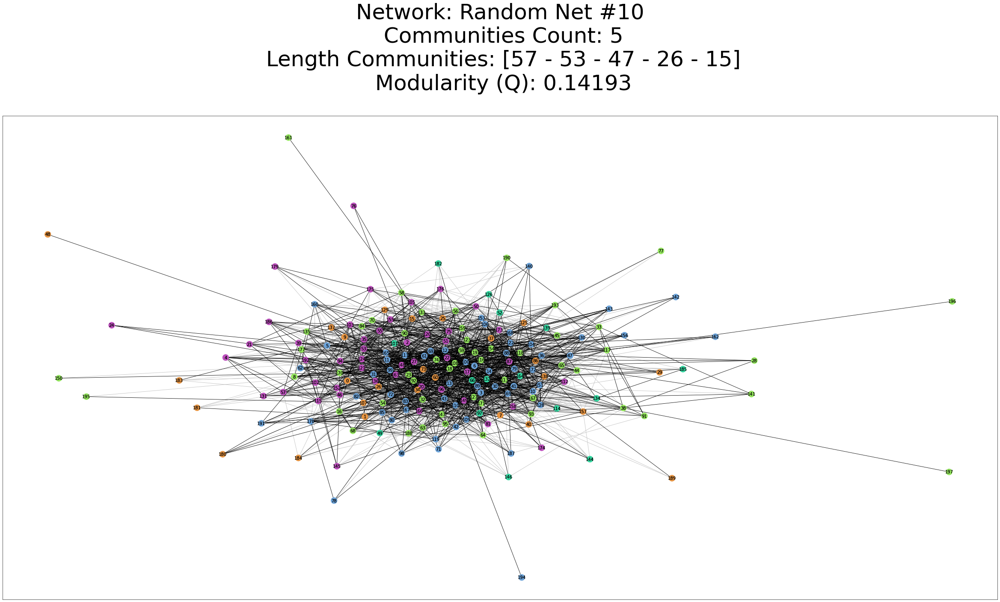

In [13]:
plotCommunities(t1_G, 'Original')

for n_i in range(len(G_10_l)):
    aux_net = G_10_l[n_i]
    plotCommunities(aux_net, 'Random Net #{}'.format(n_i + 1))